# Clustering - Mini-Project 3

## Dataset Description

The dataset file contains almost ~3000 different music genres aggregated from more than 170.000 songs collected from Spotify Web API.

Primary:

- genre (Music genre)

Numerical:

- acousticness (Ranges from 0 to 1)
- danceability (Ranges from 0 to 1)
- energy (Ranges from 0 to 1)
- duration_ms (Integer typically ranging from 200k to 300k)
- instrumentalness (Ranges from 0 to 1)
- valence (Ranges from 0 to 1)
- popularity (Ranges from 0 to 100)
- tempo (Float typically ranging from 50 to 150)
- liveness (Ranges from 0 to 1)
- loudness (Float typically ranging from -60 to 0 in decibels (dB))
- speechiness (Ranges from 0 to 1)
- year (Ranges from 1921 to 2020)


Categorical:

- key (All keys on octave encoded as values ranging from 0 to 11, starting on C as 0, C# as 1 and so on…)


**Recommended Reading for Data Understanding**: Spotify's documentation of audio features: https://developer.spotify.com/documentation/web-api/reference/tracks/get-audio-features/

**Acknowledgment**: This dataset was created and published by Yamaç Eren Ay on Kaggle.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# Suppress warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)
%matplotlib inline
plt.style.use('fivethirtyeight')
sns.set_style('whitegrid')

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/GUC-DM/W2022/main/data/music_genres.csv')
df.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


## Data Inspection

In [3]:
# check the datatypes of the columns
df.info()
# check if there are columns with null values
df.isnull().any().any()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


False

In [4]:
# Get the number of unique values in each column
for column in df.columns:
    print(f"{column}: Number of unique values {df[column].nunique()}")
    print("------------------------------------------------------------")

mode: Number of unique values 2
------------------------------------------------------------
genres: Number of unique values 2973
------------------------------------------------------------
acousticness: Number of unique values 2798
------------------------------------------------------------
danceability: Number of unique values 2725
------------------------------------------------------------
duration_ms: Number of unique values 2872
------------------------------------------------------------
energy: Number of unique values 2778
------------------------------------------------------------
instrumentalness: Number of unique values 2731
------------------------------------------------------------
liveness: Number of unique values 2709
------------------------------------------------------------
loudness: Number of unique values 2873
------------------------------------------------------------
speechiness: Number of unique values 2707
--------------------------------------------------

In [5]:
# Get the unique values for each column
for column in df.columns:
    print(f"{column} : {df[column].unique()}")
    print("--------------------------------------")

mode : [1 0]
--------------------------------------
genres : ['21st century classical' '432hz' '8-bit' ... 'zouk' 'zurich indie'
 'zydeco']
--------------------------------------
acousticness : [0.97933333 0.49478    0.762      ... 0.161      0.26326111 0.42103849]
--------------------------------------
danceability : [0.16288333 0.29933333 0.712      ... 0.74888889 0.70566667 0.62940873]
--------------------------------------
duration_ms : [ 160297.66666667 1048887.33333333  115177.         ...  306072.77777778
  198417.33333333  171671.69047619]
--------------------------------------
energy : [0.07131667 0.45067833 0.818      ... 0.62244444 0.17266667 0.60936905]
--------------------------------------
instrumentalness : [0.60683367 0.47776167 0.876      ... 0.257227   0.46863333 0.01924763]
--------------------------------------
liveness : [0.3616     0.131      0.126      ... 0.08967778 0.17966667 0.25587659]
--------------------------------------
loudness : [-31.51433333 -16.854   

## Data Preprocessing and cleaning


In [6]:
# remove rows with [] as genre value, because it has no meaning
df.drop(df[df['genres']=='[]'].index,inplace=True)
df.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
5,1,abstract,0.459210,0.516167,3.431965e+05,0.442417,0.849667,0.118067,-15.472083,0.046517,127.885750,0.307325,43.500000,1


The 2 columns: mode and duration_ms are not needed, since they don't add any value or meaning to the dataset. The mode column has no description above and it has 2 unique values 0 and 1, so we don't really know what these values mean nor what the column represents. The duration_ms column can be useful, however because the duration is in ms there are two options to go by: Either we convert the dution to be in a more useful metric, such as in minutes or seconds as most songs in the real world are OR we simply drop the column. We chose the easy route which is just dropping the column, since it doesn't add much value to the dataset anyways.

In [7]:
# Drop not needed columns 
df.drop(['mode','duration_ms'], axis='columns', inplace=True)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2972 entries, 0 to 2972
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   genres            2972 non-null   object 
 1   acousticness      2972 non-null   float64
 2   danceability      2972 non-null   float64
 3   energy            2972 non-null   float64
 4   instrumentalness  2972 non-null   float64
 5   liveness          2972 non-null   float64
 6   loudness          2972 non-null   float64
 7   speechiness       2972 non-null   float64
 8   tempo             2972 non-null   float64
 9   valence           2972 non-null   float64
 10  popularity        2972 non-null   float64
 11  key               2972 non-null   int64  
dtypes: float64(10), int64(1), object(1)
memory usage: 301.8+ KB


## Exploratory Data Analysis

**Q1: What are the 5 most popular music genres ?**

**Visualization**

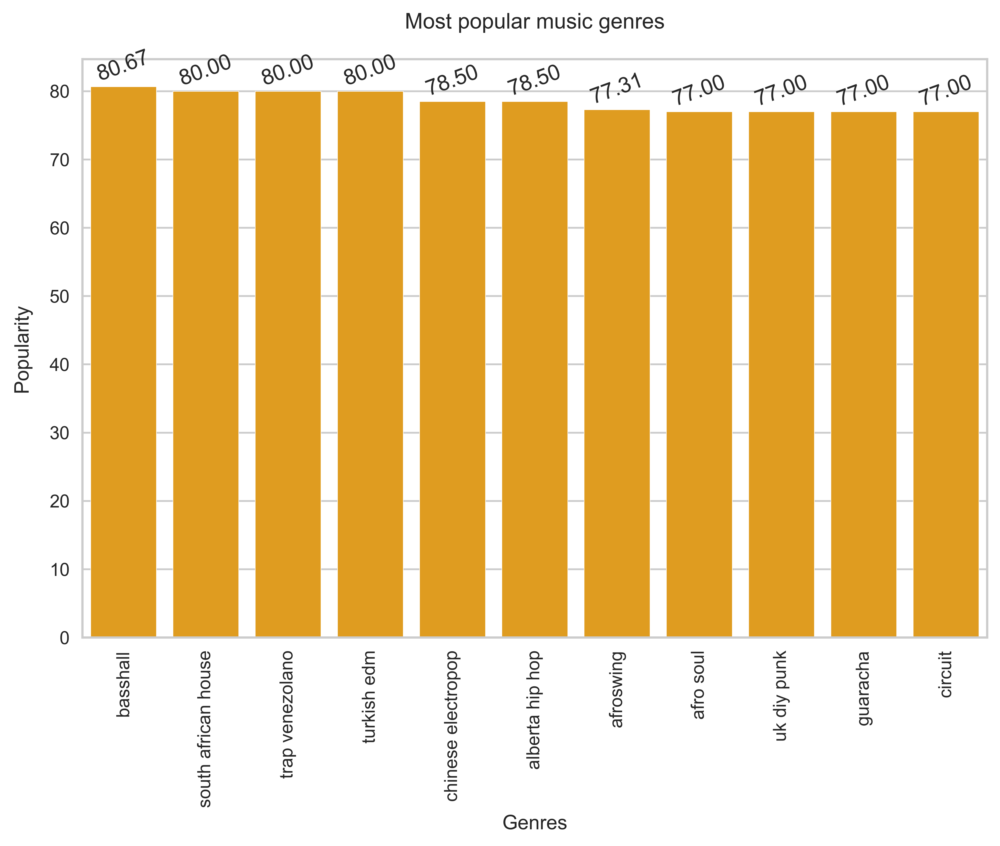

In [36]:
# set order to be sorted by popularity in descending order (high-to-low)
order=df.sort_values('popularity',ascending=False).genres
fig=sns.barplot(x='genres',y='popularity',data=df,order=order,color='orange')
# set x lim to show only the first 10 values
fig.set(xlim=(-.5,10.5),xlabel='Genres')
plt.ylabel('Popularity',labelpad=10)
plt.title('Most popular music genres',pad=17)
plt.rcParams['figure.dpi'] = 1000
plt.rcParams['savefig.dpi'] = 1000
fig.bar_label(fig.containers[0],label_type='edge',fmt='%.2f',padding=1,rotation=20)
plt.xticks(rotation=90);

The most popular music genres are basshall, south african house, trap venezolano, turkish edm and chineese electropop

**Q2: What factors affect the Popularity of the song ? (Mention the biggest 2 factors, with interpretation)**

**Visualization**

In [10]:
plt.figure(figsize = (12,9))
ax=sns.heatmap(df.corr(),cmap='viridis',annot=True,linewidths=.8);
plt.title('Correlation of attributes with popularity',fontsize=25,pad=15)
plt.rcParams['figure.dpi'] = 800
plt.rcParams['savefig.dpi'] = 800
plt.tight_layout()
for spine in ax.spines.values():
    spine.set(visible=True, lw=.8, edgecolor="black")
for label in ax.xaxis.get_ticklabels():
    if label.get_text() == 'popularity':
        label.set_fontsize(16)
        label.set_fontweight('bold')
        label.set_color('red')

The two biggest factors that affect the popularity are loudness and energy, with both having a positive correlation of 0.34 and acousticness with a negative correlation of -0.46. This means that when the loudness and energy of songs increase the popularity will also increase and when the accousticness decrease the popularity increases and vice versa.

**Q3: Which genre has the highest energy and which has the lowest ?**

**Visualization**

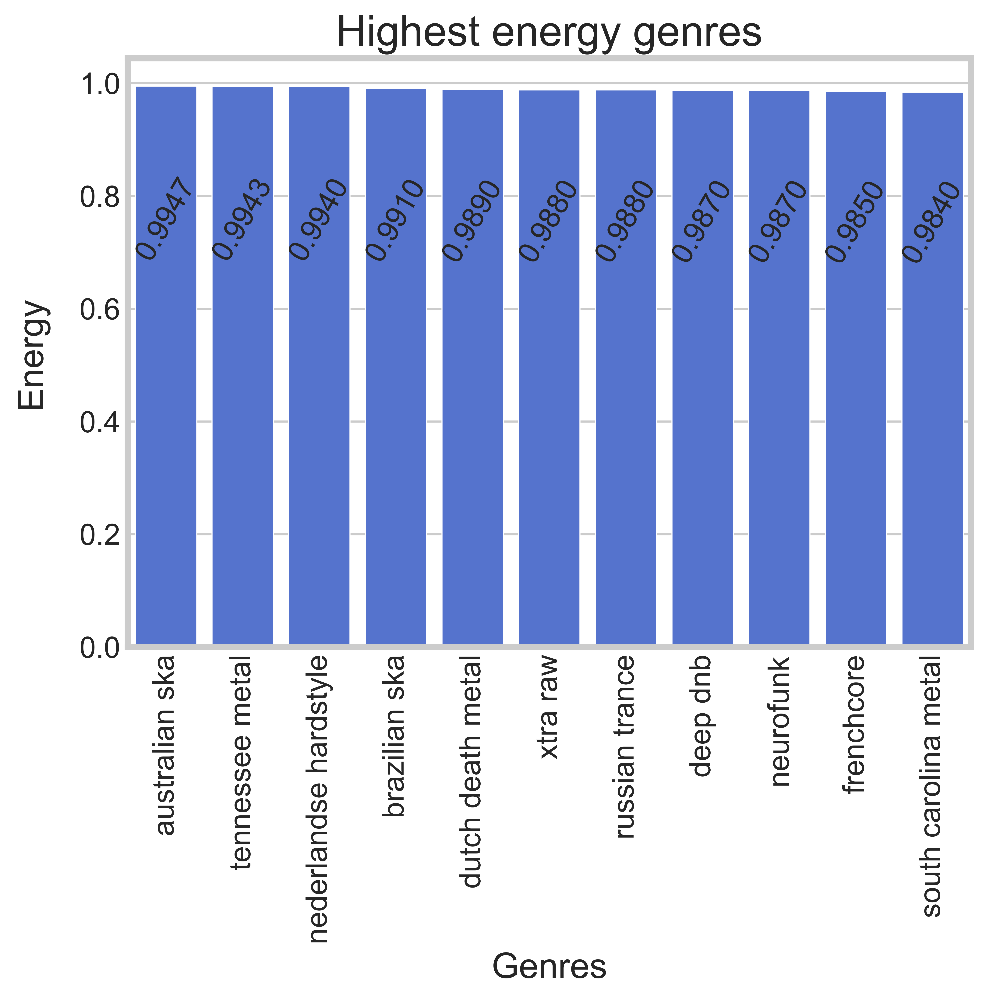

In [11]:
# set order to show energy values in descending order (from highest-to-lowest)
order=df.sort_values('energy',ascending=False).genres
fig=sns.barplot(x='genres',y='energy',data=df,order=order,color='royalblue')
# set x lim to show only the first 10 values
fig.set(xlim=(-.5,10.5),xlabel='Genres',title='Highest energy genres')
plt.ylabel('Energy',labelpad=15)
plt.xticks(rotation=90)
plt.rcParams['figure.dpi'] = 1000
plt.rcParams['savefig.dpi'] = 1000
# Label numbers
fig.bar_label(fig.containers[0],rotation=60,label_type='center',fmt='%.4f',padding=70);

The genre with the highest energy is australian ska

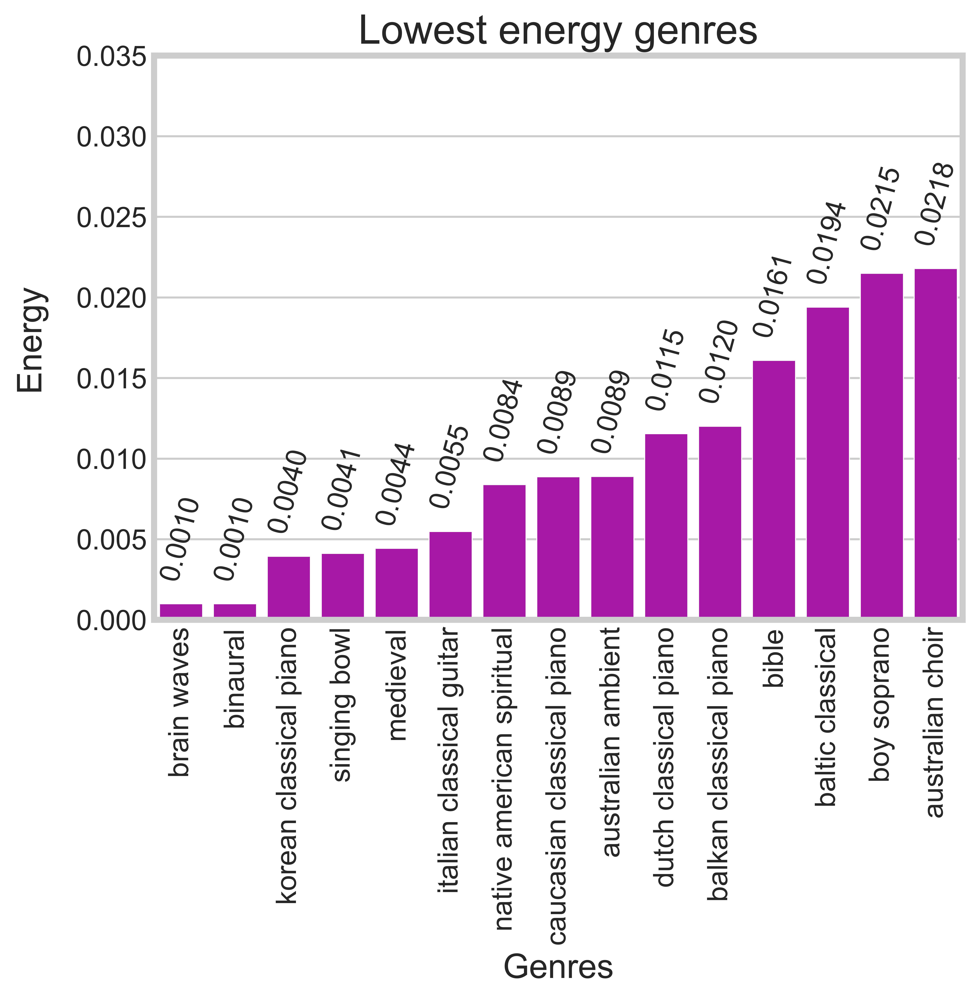

In [12]:
# set order to show energy values in ascending order-by default (from lowest-to-highest)
order=df.sort_values('energy').genres
ax=sns.barplot(x='genres',y='energy',data=df,order=order,color='m')
# set x lim to show only the first 14 values and ylim at .035 for better visualization
ax.set(xlim=(-.5,14.5),ylim=(0,.035),xlabel='Genres',title='Lowest energy genres')
plt.ylabel('Energy',labelpad=15)
plt.xticks(rotation=90);
plt.rcParams['figure.dpi'] = 1000
plt.rcParams['savefig.dpi'] = 1000
# Label numbers
ax.bar_label(ax.containers[0],rotation=75,padding=10,fmt='%.4f');

The genre with the lowest energy is brain waves at 0.0010

**Q4: What are the most correlated pairs of attributes ?**

**Visualization**

In [13]:
plt.figure(figsize = (12,9))
ax=sns.heatmap(df.corr(),cmap='afmhot_r',annot=True,linewidths=.8);
plt.title('Correlation of attributes pairs',fontsize=25,pad=10)
plt.rcParams['figure.dpi'] = 1500
plt.rcParams['savefig.dpi'] = 1500
plt.tight_layout()
for spine in ax.spines.values():
    spine.set(visible=True, lw=.8, edgecolor="black")
# for better visualization we'll assign different colors to the pairs of attributes
for label in ax.xaxis.get_ticklabels():     # x-axis
    if label.get_text() == 'energy':
        label.set_fontsize(16)
        label.set_fontweight('bold')
        label.set_color('red')
    elif label.get_text() =='acousticness':
        label.set_fontsize(16)
        label.set_fontweight('bold')
        label.set_color('b')
for label in ax.yaxis.get_ticklabels():     # y-axis
    if label.get_text() == 'loudness':
        label.set_fontsize(16)
        label.set_fontweight('bold')
        label.set_color('red')
    elif label.get_text() == 'energy':
        label.set_fontsize(16)
        label.set_fontweight('bold')
        label.set_color('b')

1. Loudness and Energy (0.85)
    -   The positive correlation explains that if the loudness or energy increases the other variable will also increase, hence the positive correlation and this also explains why both of them have the same correlation with popularity, becuause they both affect each other by the same amount
2. Energy and Acousticness (-0.87)
    -    The negative correlation explains that if the Energy increases then Accousticness decreases and vice versa, if the energy decreases the accousticness will increase. This makes sense because they both are basically two different music genres. One is more of a up-beat fast paced beat and the other is a more calm and detailed music type.

## Modelling

The genre column will need to be label encoded in order to be used in the k-means clustering algorithm, because it only works with numerical values and genre is a categorical column. Label encoding must be used because we have 2793 unique values and one-hot encoding can't be used because this method divides qualitative values into mutually exclusive categories. Label encoding will convert the categorical values into numerical one ranging from 1-2793, which are equivilant to their categorical value in the same column.

In [14]:
# Label encoding refers to transforming the categorical labels into numerical form
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
# Label encoding
df_encoded=df.copy()
df_encoded['genres']=label_encoder.fit_transform(df_encoded['genres'])
df_encoded.sample(5)

,genres,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
1041,1040,0.258405,0.747217,0.587495,0.000014,0.245364,-10.499910,0.237662,101.106407,0.548519,53.111905,2
893,892,0.635798,0.300833,0.292338,0.765024,0.136861,-19.150336,0.043749,107.522122,0.184829,40.504257,2
358,357,0.052000,0.342000,0.277000,0.188000,0.089700,-12.568000,0.040300,139.951000,0.102000,49.000000,5
492,491,0.292000,0.711500,0.603000,0.005302,0.139500,-7.103500,0.124500,99.390000,0.601000,68.500000,10
557,556,0.126314,0.701171,0.784188,0.033734,0.210073,-5.521925,0.148433,129.326354,0.604561,51.880741,1


In [15]:
#Z-Score Normalization to bring the data values in a lower range
from sklearn.preprocessing import StandardScaler
scaled_data = StandardScaler().fit_transform(df_encoded)
scaled_data

array([[-1.73146812,  1.80834218, -2.48432022, ..., -1.92725355,
        -0.72213868,  0.01828198],
       [-1.73030254,  0.2928222 , -1.57868449, ..., -1.34273793,
         0.75093152, -0.2786254 ],
       [-1.72913696,  1.12859655,  1.16023582, ...,  2.38955698,
         0.48219574,  0.31518936],
       ...,
       [ 1.72913696, -0.43129108,  1.405072  , ...,  1.64191432,
         0.40257032, -0.2786254 ],
       [ 1.73030254,  1.85108692,  1.1182007 , ...,  1.22019541,
        -2.38431924,  0.31518936],
       [ 1.73146812,  0.06218354,  0.61206723, ...,  1.56477877,
        -0.57710667,  0.31518936]])

# Choosing Optimal K

To choose the optimal K-value to be used in our clustering algorithm, which is basically the Number of clusters we apply 2 main methods, which are the Silhouette analysis method and the Elbow Curve Method.

# Silhouette analysis

The silhouette coefficient or silhouette score kmeans is a measure of how similar a data point is within-cluster (cohesion) compared to other clusters (separation).

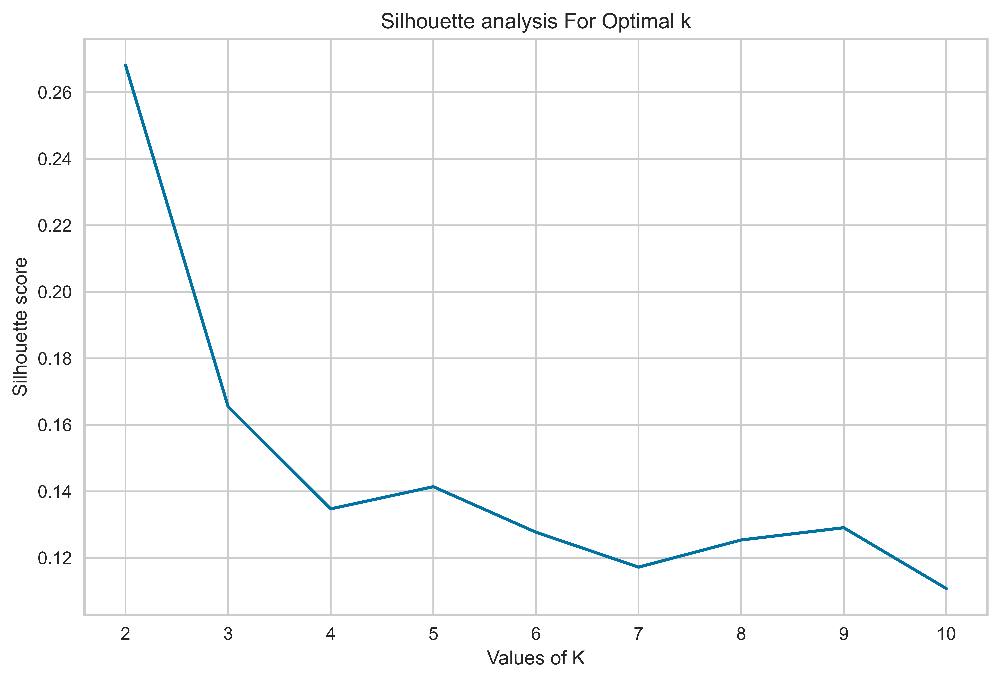

In [37]:
# Silhouette method
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

range_n_clusters = list(range(2, 11))
silhouette_avg = []
for num_clusters in range_n_clusters:
    # Initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(scaled_data)
    cluster_labels = kmeans.labels_
    # silhouette score
    silhouette_avg.append(silhouette_score(scaled_data, cluster_labels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.rcParams['figure.dpi'] = 1500
plt.rcParams['savefig.dpi'] = 1500
plt.tight_layout()
plt.show()

We'll use the ElbowVisualizer tool from yellowbrick to show the exact score and position of the best silhoutte score

In [17]:
# Silhouette Score for K means
# Import ElbowVisualizer
from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,11),metric='silhouette', timings= True)
visualizer.fit(scaled_data)         # Fit the data to the visualizer
visualizer.show();                  # Finalize and render the figure

As we can see the best silhoutte score is achieved at 2 clusters. At 2 clusters we also have the lowest fitting time.
Let's use another analysis tool to see if the optimal k still holds at 2 clusters or if we'll need to change our approach. We'll use the elbow method next

# Elbow Method

It is the most popular method for determining the optimal number of clusters. The elbow method runs k-means clustering (kmeans number of clusters) on the dataset for a range of values of k. For each of the K values, we calculate average distances to the centroid across all data points. We then Plot these points and find the point where the average distance from the centroid falls suddenly (“Elbow”).

In [18]:
# Elbow method
from sklearn.cluster import KMeans
wcss = []
for k in range( 2, 11 ):
    kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit_predict(scaled_data)
    wcss.append( kmeans.inertia_ )
    
plt.plot(range(2, 11), wcss, 'o-r', label="WCSS")
plt.title("Computing WCSS for KMeans++")
plt.xlabel("Number of Clusters")
plt.ylabel("WCSS")
plt.rcParams['figure.dpi'] = 1500
plt.rcParams['savefig.dpi'] = 1500
plt.tight_layout()
plt.show()

In [19]:
""" # Please remove the triple quotes in this line if the pip installation of the libraries is needed
%pip install yellowbrick  """;

This is another visualization of the elbow method using a better library that is mostly used when conducting machine learning algorithms, it's just a better tool since it shows the score and the exact position of the elbow

In [20]:
# Elbow Method for K means using ElbowVisualizer library
# Import ElbowVisualizer library
from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,11), timings= True)
visualizer.fit(scaled_data)         # Fit data to visualizer
visualizer.show();                   # Finalize and render figure

To choose the optimal number of cluster we'll look at the 2 analysis methods we used above, which are the Elbow method and the silhoutte score method. From the silhoutte analysis we can see that the k with the highest silhoutte score is 2.
From the silhoutte graph and scores we can tell that the highest score is achieved at 2 clusters. However when we looked at the elbow method analysis we got a different result, the highest score was achieved at k=5 according to the elbow method. We've decided to go by the elbow method and choose a number of clusters k=5, because although it doesn't have the highest silhoutte score it still came in third place, right after k=3 (Highest was k=2 then k=3 then k=5).
So we'll choose a Number of clusters of k=5  in our modeling step next.

In [21]:
km = KMeans(n_clusters=5, init='k-means++', max_iter=300, n_init=10, random_state=0)
km.fit(scaled_data)

# Get the cluster labels for the fitted data
labels = km.labels_
df['cluster'] = labels
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

df.groupby('cluster').describe()

acousticness                                                    \
               count      mean       std       min       25%       50%   
cluster                                                                  
0             1030.0  0.242435  0.159138  0.000251  0.123565  0.218490   
1              723.0  0.675727  0.186414  0.000564  0.551784  0.675000   
2              397.0  0.856995  0.159803  0.080664  0.798418  0.916401   
3               24.0  0.709561  0.181165  0.391992  0.614000  0.716645   
4              798.0  0.121205  0.132667  0.000003  0.012980  0.073378   

                            danceability                              \
              75%       max        count      mean       std     min   
cluster                                                                
0        0.339098  0.811429       1030.0  0.667309  0.085478  0.3970   
1        0.817744  0.994400        723.0  0.537285  0.096588  0.1460   
2        0.966000  0.996000        397.0  0.330774  0.103443  0.0569   
3        0.851331  0.988000         24.0  0.610082  0.060155  0.4740   
4        0.194001  0.732000        798.0  0.469654  0.116249  0.1610   

                                              energy                      \
              25%       50%       75%    max   count      mean       std   
cluster                                                                    
0        0.604017  0.667875  0.726146  0.929  1030.0  0.661286  0.106707   
1        0.485739  0.538426  0.590417  0.903   723.0  0.401580  0.119415   
2        0.268209  0.326443  0.393181  0.671   397.0  0.186968  0.122231   
3        0.570308  0.602278  0.656451  0.709    24.0  0.378280  0.223279   
4        0.398531  0.475002  0.534425  0.902   798.0  0.768278  0.136986   

                                                          instrumentalness  \
              min       25%       50%       75%       max            count   
cluster                                                                      
0        0.319000  0.588914  0.659726  0.720875  0.981000           1030.0   
1        0.055400  0.321941  0.402480  0.479318  0.900000            723.0   
2        0.001002  0.107860  0.173000  0.233606  0.980833            397.0   
3        0.022400  0.189209  0.333461  0.593500  0.740800             24.0   
4        0.277000  0.678001  0.784268  0.877209  0.994667            798.0   

                                                                          \
             mean       std  min       25%       50%       75%       max   
cluster                                                                    
0        0.073771  0.141066  0.0  0.000418  0.016177  0.077506  0.912000   
1        0.177427  0.212682  0.0  0.003344  0.089700  0.299614  0.957500   
2        0.595003  0.263072  0.0  0.439306  0.620333  0.821146  0.992000   
3        0.021921  0.073801  0.0  0.000000  0.000013  0.000464  0.349965   
4        0.234563  0.254629  0.0  0.023618  0.147569  0.372723  0.932000   

        liveness                                                              \
           count      mean       std       min       25%       50%       75%   
cluster                                                                        
0         1030.0  0.174029  0.069350  0.022200  0.132345  0.168701  0.200964   
1          723.0  0.196859  0.090569  0.040000  0.146336  0.180883  0.216958   
2          397.0  0.164214  0.094018  0.060100  0.111756  0.139028  0.181059   
3           24.0  0.372345  0.202079  0.106883  0.209568  0.318690  0.508000   
4          798.0  0.222139  0.099424  0.056800  0.167025  0.208034  0.252958   

                 loudness                                                      \
             max    count       mean       std      min        25%        50%   
cluster                                                                         
0        0.68700   1030.0  -7.799487  2.082232 -16.9960  -9.174063  -7.599119   
1        0.88300    723.0 -12.

In [22]:
df.groupby('cluster').describe(include='object')


genres                                    
         count unique                     top freq
cluster                                           
0         1030   1030                   8-bit    1
1          723    723              a cappella    1
2          397    397  21st century classical    1
3           24     24             beat poetry    1
4          798    798              acid house    1

# Clusters Interpretation

First let's show a random sample from each cluster group

In [23]:
d=locals()              #dictionairy
for i in range (0,5):   #cluster 0-4 (1-5)
    d['df'+str(i)]=df[df['cluster']==i].sample(7)
print('Random sample from cluster: ',0,'\n')
d.get('df0')

Random sample from cluster:  0 



,genres,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
1496,japanese electropop,0.083153,0.664125,0.817187,0.051774,0.223194,-5.109438,0.108825,133.750937,0.669125,59.625000,7,0
2054,okinawan pop,0.070320,0.541000,0.888500,0.018827,0.223633,-4.129000,0.051133,125.460167,0.687667,53.000000,11,0
1000,eurodance,0.092332,0.697976,0.831746,0.165565,0.207969,-8.019774,0.055031,128.761574,0.680459,53.750746,11,0
571,chunchaca,0.277724,0.712933,0.642225,0.021511,0.269325,-9.118275,0.094936,126.571125,0.871083,45.375000,5,0
427,canadian country,0.441139,0.587006,0.530311,0.037096,0.178670,-9.264775,0.043243,112.325395,0.524074,43.296365,4,0
870,dirty texas rap,0.181746,0.802520,0.540542,0.035662,0.224272,-8.416598,0.258002,131.589064,0.502832,38.069444,2,0
1112,funk,0.314614,0.636941,0.569004,0.109617,0.175339,-10.269995,0.065977,116.323365,0.651515,38.303134,7,0


In [24]:
print('Random sample from cluster: ',1,'\n')
d.get('df1')

Random sample from cluster:  1 



,genres,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
2401,ryukyu ongaku,0.988000,0.480000,0.285000,0.179000,0.120000,-10.409000,0.031300,82.534000,0.405000,0.000000,8,1
1861,musica nicaraguense,0.741964,0.514415,0.409951,0.009042,0.182050,-10.793558,0.046629,118.630821,0.598996,23.142857,5,1
2361,rockabilly,0.525290,0.554064,0.598346,0.052222,0.202202,-9.571588,0.056922,121.895943,0.730522,30.988913,9,1
1699,malian blues,0.604611,0.540861,0.372028,0.194561,0.173036,-12.969389,0.039461,123.393056,0.550111,48.638889,7,1
620,classic schlager,0.568905,0.569555,0.419191,0.001356,0.222793,-12.529580,0.057330,111.536825,0.558460,39.550000,3,1
2586,stomp and flutter,0.861077,0.572380,0.349333,0.026157,0.135130,-11.500745,0.032075,114.889995,0.374100,57.067308,3,1
203,bajki,0.952000,0.563000,0.225100,0.001313,0.106000,-13.480000,0.039750,148.955500,0.453000,50.000000,11,1


In [25]:
print('Random sample from cluster: ',2,'\n')
d.get('df2')

Random sample from cluster:  2 



,genres,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
2211,post-minimalism,0.953400,0.468992,0.197394,0.910450,0.118675,-23.929500,0.040495,107.222037,0.200930,46.637500,10,2
1994,norwegian contemporary jazz,0.732534,0.481965,0.230408,0.580207,0.136902,-17.686207,0.050186,103.823557,0.408731,27.291667,0,2
1847,musica antigua,0.995000,0.521000,0.125220,0.879000,0.126500,-24.856000,0.072450,98.515000,0.501500,0.000000,4,2
207,balkan classical piano,0.991000,0.318000,0.012015,0.917500,0.100975,-30.931500,0.039950,123.738500,0.124025,45.250000,3,2
1417,irish indie,0.988000,0.521000,0.088900,0.182000,0.096500,-19.457000,0.050700,115.430000,0.047900,69.000000,4,2
231,baroque singing,0.935000,0.193000,0.095000,0.277000,0.109000,-23.482000,0.046800,107.440000,0.041900,50.000000,4,2
2658,swiss classical piano,0.985903,0.352404,0.099721,0.610978,0.124521,-22.997322,0.055538,98.232831,0.261002,1.669192,10,2


In [26]:
print('Random sample from cluster: ',3,'\n')
d.get('df3')

Random sample from cluster:  3 



,genres,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
1649,latino comedy,0.424880,0.536400,0.740800,0.000000e+00,0.495000,-11.488000,0.535400,106.188000,0.448800,45.000000,6,3
249,beat poetry,0.703833,0.607556,0.178872,1.688422e-04,0.161942,-20.827278,0.422472,122.336361,0.466906,12.027778,10,3
2309,reading,0.729457,0.613915,0.225348,5.792737e-06,0.315305,-21.604240,0.815643,96.783299,0.436603,3.347801,11,3
911,dutch cabaret,0.981500,0.583500,0.376500,3.499650e-01,0.415500,-16.991500,0.638500,76.849000,0.590500,6.500000,7,3
1184,ghanaian traditional,0.587000,0.612000,0.022400,0.000000e+00,0.124000,-22.180000,0.677000,180.250000,0.284000,1.000000,1,3
518,children's story,0.525167,0.651667,0.380333,1.783333e-07,0.106883,-14.361500,0.440933,86.749500,0.572833,30.666667,11,3
1931,new comedy,0.852325,0.553775,0.697725,2.778875e-04,0.749700,-9.282775,0.859005,98.879475,0.460120,37.925000,11,3


In [27]:
print('Random sample from cluster: ',4,'\n')
d.get('df4')

Random sample from cluster:  4 



,genres,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,cluster
965,electronic djent,0.038201,0.510250,0.641000,0.819750,0.166250,-9.091500,0.067150,130.525250,0.145500,60.250000,2,4
942,easycore,0.120472,0.549657,0.919667,0.002586,0.216584,-3.977429,0.131738,126.577590,0.567276,45.590476,8,4
504,chicago hardcore,0.019460,0.347619,0.893039,0.061644,0.221874,-7.728963,0.066487,121.082167,0.506070,39.059259,11,4
1400,instrumental post-rock,0.195237,0.379726,0.549331,0.707045,0.167890,-10.871536,0.050988,115.017690,0.174705,46.440476,2,4
2590,stoner metal,0.041122,0.375672,0.806928,0.460335,0.173014,-7.307092,0.061370,122.188977,0.390838,43.837920,5,4
261,belgian edm,0.054329,0.698979,0.761146,0.280704,0.191900,-6.573313,0.129060,130.822615,0.444688,50.250000,11,4
1500,japanese garage rock,0.391700,0.543500,0.859500,0.322536,0.501500,-8.170000,0.042450,151.168000,0.808000,44.000000,11,4


**Cluster interpretation with attributes**

In [28]:
# Plot 1
# for col in df.select_dtypes('number').columns:
#     plt.figure()
#     sns.barplot(x='cluster', y=col, data=df,ci=False,palette='mako')

# Plot 2 
cols = df.select_dtypes('number').columns.drop(['cluster'])
n = int(len(cols)**(1/2))
plt.figure(figsize=(13,15))
for i, col in enumerate(cols, 1):
    plt.subplot(n+1, n, i)
    sns.barplot(x='cluster', y=col, data=df,ci=False,palette='mako')

Let's interpret each cluster group in connection to the attricbutes

**Interpretation**

-   Cluster #0 are the most popular genre. They also have the hihest danceability. They are the 2nd highest genres in energy. They are the 2nd lowest genres in instrumentallness and liveness and accousticness. They are als the 2nd highest genres in loudness and speechiness and tempo. They are also the highest genres in valence. And lastly they are the 3rd highest genres in key ocatves.

-   Cluster #1 are the 2nd lowest popular genres. They are the 3rd highest in accousticness, danceability, energy, instrumentallness, liveness and tempo. They are also the 3rd quietest genres and the 2nd lowest in speechiness. They are also the 2nd highest in valence. And lastly they are the 3rd highest genres in key octaves

-   Cluster #2 are the third highest popular genres. They have the most accousticness and instrumentalness by a very big margin in comparison to the others. They also have the lowest danceability, energy, liveness, speechiness and valence. They are also the least loud genres, so they are the quietest by far. They are the 2nd lowest in tempo. And lastly the have the lowest key octave in comparison to other, which explains why they are so quiet.

-   Cluster #3 are the least popular song genres. They are the 2nd highest in accousticness, danceability. They are the 2nd lowest in energy. They are the lowest genres in instrumentallness by a far. They are the highest genres in liveness. They are the 2nd quietest song genres. CLuster #3 genres are the highest cluster in speechiness by an insane margin. They have a speechinees of 0.7+ while the 2nd highest cluster group is cluster #0 at only 0.1. They are also the lowest genres in tempo. They are also the 3rd highest in valence. And lastly they are the highest genres in key octave

-   Cluster #4 are the second highest popular genres. They have the lowest accousticness and valence. They also have the 2nd lowest danceability. They have the highest energy and loudness and tempo in comparison to all other groups. They are also the 2nd highest in instrumentalness and liveness and key octaves. They are the 3rd highest genres in speechiness. 

**Findings**

From the cluster interpretation we have basically confirmed our initial partly analysis before we applied the clustering algorithm. We can see that Cluster #0 is the most popular cluster and it contanins a similar correlation like we observed in Q2 when we made the heatmap. The most correlated attributes with popularity were loudness and energy, with both having a positive correlation of 0.34 and acousticness with a negative correlation of -0.46. This means that when the loudness and energy of songs increase the popularity will also increase and when the accousticness decrease the popularity increases and vice versa. This would translate into people liking more upbeat songs and music genres with fast paced beats. That's also the reason we observed the top 5 music genres where basshall is the top music genre. Basshall brings in a variety of Caribbean sounds accompanied by peculiar drum patterns, live instrumentation and a distinguished street-like charm. Dutch duo, Tribal Kush, began to grow in popularity on Youtube as they uploaded track after track that resonated with an insatiated young audience. The platform evolved and quickly became what is now called Basshall Records, a record label that reps unique sounds with a worldwide appeal. An example of a basshall song by the artists Blaiz Fayah & Tribal Kush with 48 million views on youtube [Blaiz Fayah & Tribal Kush - Bad (Official Music Video)](https://www.youtube.com/watch?v=ujnqNTQRw6k).

Cluster #0 has the 2nd highest energy and they are the 2nd lowest genres in instrumentallness and liveness and accousticness.They are als the 2nd highest genres in loudness and speechiness and tempo. This confirms that people like more upbeat and energetic songs in comparison to lower beat and low energy songs like we observed with Cluster #3. Cluster #3 are the least popular song genres. They are the 2nd highest in accousticness, danceability. They are the 2nd lowest in energy. They are the lowest genres in instrumentallness by a far. They are the highest genres in liveness. They are the 2nd quietest song genres. Cluster #3 genres are the highest cluster in speechiness by an insane margin. They have a speechinees of 0.7+ while the 2nd highest cluster group is cluster #0 at only 0.1. They are also the lowest genres in tempo. They are also the 3rd highest in valence. And lastly they are the highest genres in key octave. So like we observed they are low in energy, tempo and loudness and high in accoussticness and speechineess. And that's why it's considered boring and not popular 

# Bonus

**Part 1: Q5 (Bonus): Plot the words frequency in genres. Which main genre categories have the most sub-genres? (mention
at least 3)**

There are 2 ways to get the words frequency in genres. The first method is easy, because it uses a premade library called nltk (Natural Language Toolkit), which can just put the words into tokens and get it's frequency

In [29]:
""" # Please remove the triple quotes in this line if the pip installation of the libraries is needed
%pip install nltk  """;

In [30]:
# import lib
import nltk
nltk.download('punkt')  # << necessary

num = 10    # limit to top 10
q = df['genres'].str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(q)
word_dist = nltk.FreqDist(words)
rslt = pd.DataFrame(word_dist.most_common(num),columns=['Word', 'Frequency'])   # to-dataframe

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Estorko\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [31]:
rslt.head()

,Word,Frequency
0,pop,240
1,indie,237
2,rock,183
3,metal,132
4,classical,106


The second method is just a simple split method on the genre column with a value_counts() call to get the number of times this "split" occured

In [32]:
# Split method
res=df.genres.str.split(expand=True).stack().value_counts()
res.head()

pop          240
indie        237
rock         183
metal        132
classical    106
dtype: int64

To visualize it we'll just use the dataframe from nltk, but both methods will result in the same thing (we can also just convert "res" to a df aswell) but since with the ntlk we already have it limited to 10 outputs that will save us some work 

**Visualization**

In [33]:
# barplot to plot word frequency
sns.barplot(x='Word',y='Frequency',data=rslt,ci=False,palette='flare')
plt.rcParams['figure.dpi'] = 700
plt.rcParams['savefig.dpi'] = 700

The most frequent word occuring in the genres is "pop" which is a main category. The genre with the most sub-genres is pop followed by indie and rock

**Part 2: Use your clustering model in a function that takes in a music genre as a parameter, and recommends a few
similar genres to explore**

In [34]:
# list to store the genres
res=[]
def genre_recommender():
    global value               # make global so it's accesible outside this function
    # get input from user
    value = input("Please enter a genre: \n")
    # locate the row of the music genre that was inputted
    g=df.loc[df['genres']==value]
    # store the cluster group
    cluster=g['cluster'].item()
    # make a sample of 7 genres within the same cluster group
    res.append(df[df['cluster']==cluster].sample(7).genres)
genre_recommender()
# convert to df for better visualization
t=pd.DataFrame(res).transpose()
t.columns = ['Genres']       # set col
# reset index so it doesn't show the original row numbers without any order (Row 1541 then 5 for example)  
t=t.reset_index(drop=True)  
t                            # show df

,Genres
0,vintage country folk
1,country blues
2,ilocano pop
3,coverchill
4,experimental big band
5,bush ballad
6,thai idol


In case we want our genre recommender to just output the recommended genres without the rows we can use the following code:

In [35]:
lis=t['Genres'].tolist()    #convert to list
out=""
print("Genre recommendations for: ",value,'\n'+'--------------------------------------')
# for i in range(len(t)):
    # print(t._get_value(i,'Genres'))
for i in lis:
    out=', '.join(lis)
print("Recommended genres= ",out)

Genre recommendations for:  jazz 
--------------------------------------
Recommended genres=  vintage country folk, country blues, ilocano pop, coverchill, experimental big band, bush ballad, thai idol


Here our genre recommender will do the following: First it will search for the passed input genre and locate its' row and store it in the variable g. After that we'll get the cluster number and store it in the cluster variable. Lastly we'll append to the res list a sample of 7 entries with the same cluster to randomize the results and only store the genre column (the row will be stored automatically aswell). For better visualization we'll just use the variable t to store a dataframe of the res (list) so we can see the results better